In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
from pandas_profiling import ProfileReport

In [3]:
DATA_PATH = '../data/'

df = pd.read_csv(DATA_PATH + 'raw/public-train.csv')
df.head()

,n,p,f,x,y,z,a1,a2,a3,a4,...,g1,g2,l1,l2,l3,l4,e1,e2,cent_price_cor,cent_trans_cor
0,709,0.7,0.2,16,12,7,3.8,0.24,2.3,0.28,...,0.186,0.5,0.147,1.5,0.089,1.6,1.5,2.6,-0.169,0.375
1,921,0.6,0.3,19,17,10,3.0,0.12,2.4,0.19,...,0.079,1.2,0.186,1.6,0.076,1.8,0.6,0.4,-0.075,0.234
2,177,0.8,0.4,14,12,5,3.2,0.17,1.8,0.18,...,0.036,1.4,0.048,0.7,0.073,0.6,2.7,0.3,-0.177,0.389
3,415,0.7,0.5,24,11,2,1.3,0.17,1.5,0.18,...,0.063,1.1,0.151,0.8,0.022,1.1,0.5,0.1,-0.102,0.358
4,802,0.8,0.4,21,10,3,4.4,0.15,2.6,0.13,...,0.044,1.9,0.123,1.9,0.046,1.1,2.0,0.6,-0.034,0.180


In [10]:
profile = ProfileReport(df, title="EDA - ITA Challenge")
profile

## Descrição das variáveis
### Preditoras
* Agentes:
    * **n:** Número de agentes na simulação
    * **p:** Fração de traders
    * **f:** Grau de interesse dos traders


* Espaço:
    * **x:** Dimensão do espaço em X
    * **y:** Dimensão do espaço em Y
    * **z:** Dimensão do espaço em Z
    * Obs -> Essa variáveis são discretizadas
    
    
* Preço fundamental:
    * **a1:** Média do coeficiente para dos consumidores
    * **a2:** Desvio padrão do coeficiente para consumidores
    * **a3:** Média do coeficiente para traders
    * **a4:** Desvio padrão do coeficiente para traders
    
    
* Preço de mercado:
    * **b1:** Média do coeficiente para dos consumidores
    * **b2:** Desvio padrão do coeficiente para consumidores
    * **b3:** Média do coeficiente para traders
    * **b4:** Desvio padrão do coeficiente para traders
    
    
* Grau de agressividade dos consumidores:
    * **g1:** Média
    * **g2:** Desvio padrão
    
    
* Desvalorização:
    * **l1:** Média do coeficiente para dos consumidores
    * **l2:** Desvio padrão do coeficiente para consumidores
    * **l3:** Média do coeficiente para traders
    * **l4:** Desvio padrão do coeficiente para traders
    
    
* Variabilidade no preço fundamental:
    * **e1:** Para consumidores
    * **e2:** Para traders
    

### Alvo
Ambas são correlações de pearson:
* **cent_price_cor**: Entre o preço final e a centralidade das permissões de vôo
* **cent_trans_cor**: Entre o número de transações e a centralidade das permissões de vôo

## Insights
* Não existem valores nulos!


* f e p foram consideradas categóricas, apesar de serem numéricas


* Distribuições
    1. Todas as variáveis preditoras apresentam distribuição aproximadamente uniforme, isso provavelmente tem relação com a maneira como essas simulações foram geradas.
    2. As variáveis alvo apresentam distribuições próximas de uma distribuição normal, sendo a cent_trans_cor mais diferente.
    

* Correlações
    1. A matrix de correlação não indica quase nenhuma correlação entre variáveis
    2. A unica correlação forte encontrada é negativa entre **cent_price_cor** e **cent_trans_cor**

<AxesSubplot:ylabel='cent_price_cor'>

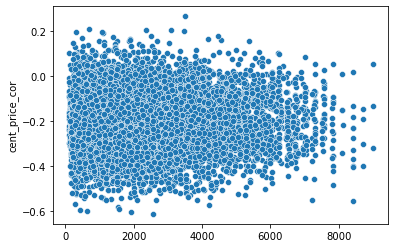

In [15]:
sns.scatterplot(data=df, x=df['x']*df['y']*df['z'], y='cent_price_cor')

## Ideias de features
* Espaciais:
    * espaco_total: x.y.z 
    * espaco_lateral: x.y
    * Isso pode ser aplicado para todas as combinações possíveis
    

* Fracoes:
    * n_traders: n.p
    * n_traders_int: n.p.f
    
    
* Seria bom encontrar algo para média e desvio padrão, pois isso se repete para a maioria das features